<a href="https://colab.research.google.com/github/felipe-parodi/imitation-learning-cis522/blob/main/SAC_TD3_Baselines.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Deep RL Stable Baselines for PyBullet Humanoid-v0**
### Teaching Humanoid to Walk with Soft Actor-Critic (SAC) and Twin Delayed DDPG (TD3)
Stable Baselines Github Repo: [https://github.com/DLR-RM/stable-baselines3](https://github.com/DLR-RM/stable-baselines3)

## **Setup**

In [ ]:
#@markdown #### Mount drive
from google.colab import drive
drive.mount('/content/drive')

# %ls
%cd /content/drive/MyDrive/DRL

Mounted at /content/drive
/content/drive/MyDrive/DRL


In [ ]:
#@markdown #### Install modules/packages
%%capture 
!pip install stable-baselines3[extra] pybullet
!apt install swig cmake

import gym
import pybullet_envs
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

import os
from IPython import display
from matplotlib import animation
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython import display
from IPython.display import Image # display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
%config InlineBackend.figure_format = 'retina'

plt.rcParams.update(plt.rcParamsDefault)
plt.rc('animation', html='jshtml')

from stable_baselines3 import SAC
from stable_baselines3 import TD3
from stable_baselines3.common import results_plotter
from stable_baselines3.common.noise import NormalActionNoise
from stable_baselines3.common.evaluation import evaluate_policy
from stable_baselines3.common.callbacks import CheckpointCallback, EveryNTimesteps
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.results_plotter import load_results, ts2xy
from stable_baselines3.common.callbacks import BaseCallback

In [ ]:
#@markdown #### Helper Functions
class SaveOnBestTrainingRewardCallback(BaseCallback):
    """
    Callback for saving a model (the check is done every ``check_freq`` steps)
    based on the training reward (in practice, we recommend using ``EvalCallback``).

    :param check_freq: (int)
    :param log_dir: (str) Path to the folder where the model will be saved.
      It must contains the file created by the ``Monitor`` wrapper.
    :param verbose: (int)
    """
    def __init__(self, check_freq: int, log_dir: str, verbose=1):
        super(SaveOnBestTrainingRewardCallback, self).__init__(verbose)
        self.check_freq = check_freq
        self.log_dir = log_dir
        self.save_path = os.path.join(log_dir, 'best_model')
        self.best_mean_reward = -np.inf

    def _init_callback(self) -> None:
        # Create folder if needed
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self) -> bool:
        if self.n_calls % self.check_freq == 0:

          # Retrieve training reward
          x, y = ts2xy(load_results(self.log_dir), 'timesteps')
          if len(x) > 0:
              # Mean training reward over the last 100 episodes
              mean_reward = np.mean(y[-100:])
              if self.verbose > 0:
                print(f"Num timesteps: {self.num_timesteps}")
                print(f"Best mean reward: {self.best_mean_reward:.2f} - Last mean reward per episode: {mean_reward:.2f}")

              # New best model, you could save the agent here
              if mean_reward > self.best_mean_reward:
                  self.best_mean_reward = mean_reward
                  # Example for saving best model
                  if self.verbose > 0:
                    print(f"Saving new best model to {self.save_path}.zip")
                  self.model.save(self.save_path)

        return True


def moving_average(values, window):
    """
    Smooth values by doing a moving average
    :param values: (numpy array)
    :param window: (int)
    :return: (numpy array)
    """
    weights = np.repeat(1.0, window) / window
    return np.convolve(values, weights, 'valid')


def plot_results(log_folder, title='Learning Curve'):
    """
    plot the results

    :param log_folder: (str) the save location of the results to plot
    :param title: (str) the title of the task to plot
    """
    x, y = ts2xy(load_results(log_folder), 'timesteps')
    y = moving_average(y, window=50)
    # Truncate x
    x = x[len(x) - len(y):]

    fig = plt.figure(title)
    plt.plot(x, y)
    plt.xlabel('Number of Timesteps')
    plt.ylabel('Rewards')
    plt.title(title + " Smoothed")
    plt.show()

## **Deep Learning Baseline: Soft-Actor Critic (SAC)**


In [ ]:
#@markdown #### Train model and save

# create respective folders 

# Create log dir
log_dir = '/content/drive/MyDrive/DRL/sac/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)

# Create the callback: check every 1000 steps
callback = SaveOnBestTrainingRewardCallback(check_freq=1000, log_dir=log_dir)

# Instantiate, train, and save the agent
sac_model = SAC("MlpPolicy", env, verbose=1)
sac_model.learn(total_timesteps=600000, log_interval=1000, callback=callback)
sac_model.save(log_dir + "sac_humanoid")

## Delete to demonstrate loading the trained agent
# del model
# model = SAC.load(log_dir + "sac_humanoid") # Load the trained agent

# Evaluate the agent
mean_reward, std_reward = evaluate_policy(model, model.get_env(), n_eval_episodes=100)

print("==== Results ====")
print("Episode_reward={:.2f} +/- {:.2f}".format(mean_reward, std_reward))

obs = env.reset()
for s in range(total_timesteps):
    action, _states = sac_model.predict(obs)
    obs, rewards, done, info = env.step(action)
    env.render()
    if done:
      obs = env.reset()

env.close()

In [ ]:
#@markdown #### Continue training SAC
import os 
log_dir = '/content/drive/MyDrive/DRL/sac/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir, allow_early_resets=True)

# Create the callback: check every 1000 steps
callback = SaveOnBestTrainingRewardCallback(check_freq=1000, log_dir=log_dir)
total_timesteps = 500000
model = SAC.load(log_dir + "sac_humanoid.zip", env=env, verbose=2).learn(total_timesteps=total_timesteps, log_interval=1000, callback=callback)
model.save(log_dir + "sac_humanoid")

# Evaluate the agent
mean_reward, std_reward = evaluate_policy(model, model.get_env(), n_eval_episodes=100)

print("==== Results ====")
print("Episode_reward={:.2f} +/- {:.2f}".format(mean_reward, std_reward))

# obs = env.reset()
# for s in range(total_timesteps):
#     action, _states = model.predict(obs)
#     obs, rewards, done, info = env.step(action)
#     env.render()
#     if done:
#       obs = env.reset()

# env.close()

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Wrapping the env in a DummyVecEnv.
Num timesteps: 1000
Best mean reward: -inf - Last mean reward per episode: -20.31
Saving new best model to /content/drive/MyDrive/DRL/sac/best_model.zip
Num timesteps: 2000
Best mean reward: -20.31 - Last mean reward per episode: -13.89
Saving new best model to /content/drive/MyDrive/DRL/sac/best_model.zip
Num timesteps: 3000
Best mean reward: -13.89 - Last mean reward per episode: -10.96
Saving new best model to /content/drive/MyDrive/DRL/sac/best_model.zip
Num timesteps: 4000
Best mean reward: -10.96 - Last mean reward per episode: -13.40
Num timesteps: 5000
Best mean reward: -10.96 - Last mean reward per episode: -21.70
Num timesteps: 6000
Best mean reward: -10.96 - Last mean reward per episode: -24.56
Num timesteps: 7000
Best mean reward: -10.96 - Last mean reward per episode: -28.69
Num timesteps: 8000
Best mean reward: -10.96 - Last mean reward per episode: -35.45
Num timesteps: 9000
Best mean reward: -10.96 - Last mean reward per episode: -44.1

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Num timesteps: 500000
Best mean reward: 631.43 - Last mean reward per episode: 622.25
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-4-02d0c5e85a33>", line 16, in <module>
    mean_reward = np.mean(episode_rewards)
NameError: name 'episode_rewards' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 1823, in showtraceback
    stb = value._render_traceback_()
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/ultratb.py", line 1132, in get_records
    return _fixed_getinnerframes(etb,

NameError: ignored

In [ ]:
#@markdown #### Visualize scatter plot of rewards
# Helper from the library
import os 
log_dir = '/content/drive/MyDrive/DRL/sac/'
results_plotter.plot_results([log_dir], 1e5, results_plotter.X_TIMESTEPS, "SAC Humanoid-v0")

AssertionError: ignored

In [ ]:
#@markdown #### Plot moving average of rewards
plot_results(log_dir, title='Learning Curve for SAC Humanoid-v0')

AssertionError: ignored

In [ ]:
#@markdown #### Visualize agent, change gif name before
def visualize(env, model, ep_steps):
    # Simulate agent in environment
    frames = []
    obs = env.reset()
    for s in range(ep_steps):
        action, _states = model.predict(obs)
        obs, rewards, done, info = env.step(action)

        display.clear_output(wait=True)
        frames.append(env.render('rgb_array'))
        obs = obs
        if done:
            break
    
    # Generate video
    plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi=72)
    patch = plt.imshow(frames[0])
    plt.axis('off')
    animate = lambda i: patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, frames=range(len(frames)), interval=50)
    plt.close() # avoid showing extra plots

    f = "/content/drive/MyDrive/DRL/sac/sac_8.gif" 
    writergif = animation.PillowWriter(fps=30) 
    anim.save(f, writer=writergif)
    return anim
  
# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir, allow_early_resets=True)
model = SAC.load(log_dir + "sac_humanoid.zip", env=env, verbose=2)
visualize(env, model, 1000)

Animation size has reached 21003629 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## **Advanced DRL Baseline: Twin Delayed DDPG (TD3)**

In [ ]:
#@markdown #### Train model and save

# create respective folders 
import os

# Create log dir
log_dir = '/content/drive/MyDrive/DRL/td3/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)

# Create the callback: check every 1000 steps
callback = SaveOnBestTrainingRewardCallback(check_freq=1000, log_dir=log_dir)

# The noise objects for TD3
n_actions = env.action_space.shape[-1]
action_noise = NormalActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))

# Instantiate, train, and save the agent
td3_model = TD3("MlpPolicy", env, action_noise=action_noise, verbose=1)
td3_model.learn(total_timesteps=700000, log_interval=1000,callback=callback)
td3_model.save(log_dir + "td3_humanoid")
env = td3_model.get_env()

# Evaluate the agent
mean_reward, std_reward = evaluate_policy(model, model.get_env(), n_eval_episodes=100)

print("==== Results ====")
print("Episode_reward={:.2f} +/- {:.2f}".format(mean_reward, std_reward))

obs = env.reset()
while True:
    action, _states = td3_model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    env.render()
    if done:
      obs = env.reset()

env.close()

In [ ]:
#@markdown #### Continue training TD3
import os 
log_dir = '/content/drive/MyDrive/DRL/td3/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)

# Create the callback: check every 1000 steps
callback = SaveOnBestTrainingRewardCallback(check_freq=1000, log_dir=log_dir)
total_timesteps=500000
model = TD3.load(log_dir + "td3_humanoid.zip", env=env, verbose=2).learn(total_timesteps=total_timesteps, log_interval=1000, callback=callback)
model.save(log_dir + "td3_humanoid")

# Evaluate the agent
mean_reward, std_reward = evaluate_policy(model, model.get_env(), n_eval_episodes=100)

print("==== Results ====")
print("Episode_reward={:.2f} +/- {:.2f}".format(mean_reward, std_reward))

obs = env.reset()
while True:
    action, _states = model.predict(obs)
    obs, rewards, done, info = env.step(action)
    env.render()
    if done:
      obs = env.reset()

env.close()

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Wrapping the env in a DummyVecEnv.
Num timesteps: 1000
Best mean reward: -inf - Last mean reward per episode: -34.98
Saving new best model to /content/drive/MyDrive/DRL/td3/best_model.zip
Num timesteps: 2000
Best mean reward: -34.98 - Last mean reward per episode: 61.01
Saving new best model to /content/drive/MyDrive/DRL/td3/best_model.zip
Num timesteps: 3000
Best mean reward: 61.01 - Last mean reward per episode: 15.46
Num timesteps: 4000
Best mean reward: 61.01 - Last mean reward per episode: -7.30
Num timesteps: 5000
Best mean reward: 61.01 - Last mean reward per episode: -14.26
Num timesteps: 6000
Best mean reward: 61.01 - Last mean reward per episode: -13.33
Num timesteps: 7000
Best mean reward: 61.01 - Last mean reward per episode: -11.60
Num timesteps: 8000
Best mean reward: 61.01 - Last mean reward per episode: -24.43
Num timesteps: 9000
Best mean reward: 61.01 - Last mean reward per episode: -20.13
Num timesteps: 10000
Best mean reward: 61.01 - Last mean reward per episode: -1

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

array([], dtype=float64)

In [ ]:
#@markdown #### Visualize scatter plot of rewards
# Helper from the library
import os 
log_dir = '/content/drive/MyDrive/DRL/td3/'
results_plotter.plot_results([log_dir], 1e5, results_plotter.X_TIMESTEPS, "TD3 Humanoid-v0")

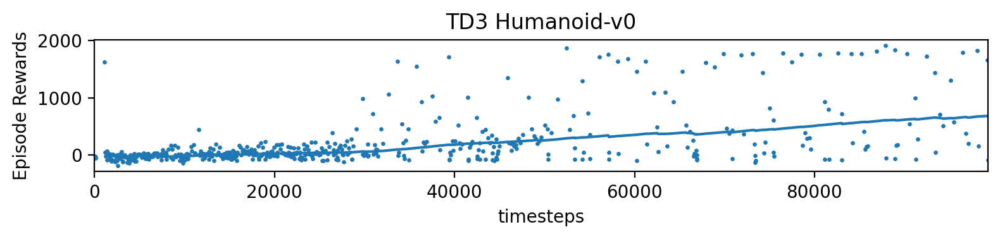

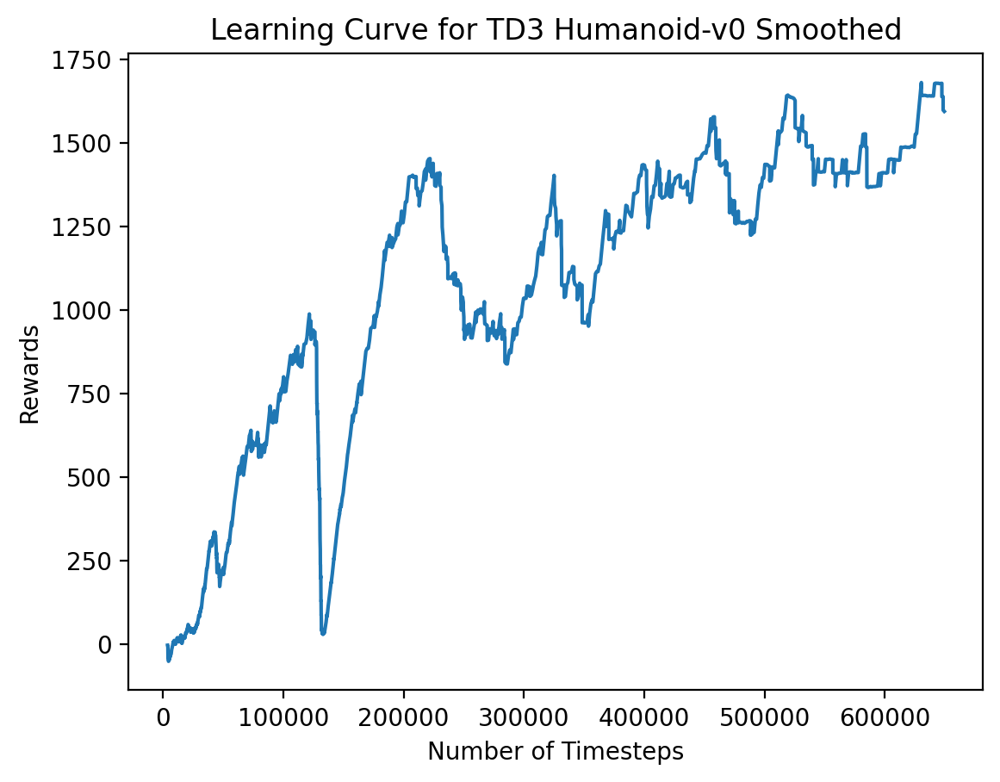

In [ ]:
#@markdown #### Plot moving average of rewards
plot_results(log_dir, title='Learning Curve for TD3 Humanoid-v0')

In [ ]:
#@markdown #### Visualize agent, change gif name before
import matplotlib
# matplotlib.rcParams['animation.embed_limit'] = 2**128

def visualize(env, model, ep_steps):
    # Simulate agent in environment
    frames = []
    obs = env.reset()
    for s in range(ep_steps):
        action, _states = model.predict(obs)
        obs, rewards, done, info = env.step(action)

        display.clear_output(wait=True)
        frames.append(env.render('rgb_array'))
        obs = obs
        if done:
            break
    
    # Generate video
    plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi=72)
    patch = plt.imshow(frames[0])
    plt.axis('off')
    animate = lambda i: patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, frames=range(len(frames)), interval=50)
    plt.close() # avoid showing extra plots

    f = "/content/drive/MyDrive/DRL/td3/td3_7.gif" 
    writergif = animation.PillowWriter(fps=30) 
    anim.save(f, writer=writergif)
    return anim

env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)
model = TD3.load(log_dir + "td3_humanoid.zip", env=env, verbose=2)
visualize(env, model, 1000)


## **Compare Performance**

In [ ]:
#@markdown #### Histogram of SAC Rewards
log_dir = '/content/drive/MyDrive/DRL/sac/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)

model = SAC.load(log_dir + "sac_humanoid.zip", env=env, verbose=2)

# Initialize values
num_iter=1000
ep_steps=2000
all_reward = []
num_steps  = []
done = 0

# Iterate over each episode
for i in range(num_iter):
  obs = env.reset() # Reset environment
  total_reward = 0 # initialize total reward for accumulation
  for s in range(ep_steps):
    action, _states = model.predict(obs) # make a prediction
    obs, reward, done, info = env.step(action) # take a step
    total_reward += reward # add to total reward
    #print('Total Reward: ', total_reward)
    if done:
      all_reward.append(total_reward) # append to initial list
      num_steps.append(s) # append number of episode steps
      #print('All reward: ', all_reward) # should fall b/w 1100-1200
      #print('Num steps: ', num_steps)
      break

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Wrapping the env in a DummyVecEnv.


In [ ]:
# Save as npz
log_dir = '/content/drive/MyDrive/DRL/sac/sac_humanoid.zip'
all_reward = np.savez("sac_1000iter_humanoid",
                    all_reward=all_reward,num_steps=num_steps,checkpoint=log_dir)

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Wrapping the env in a DummyVecEnv.


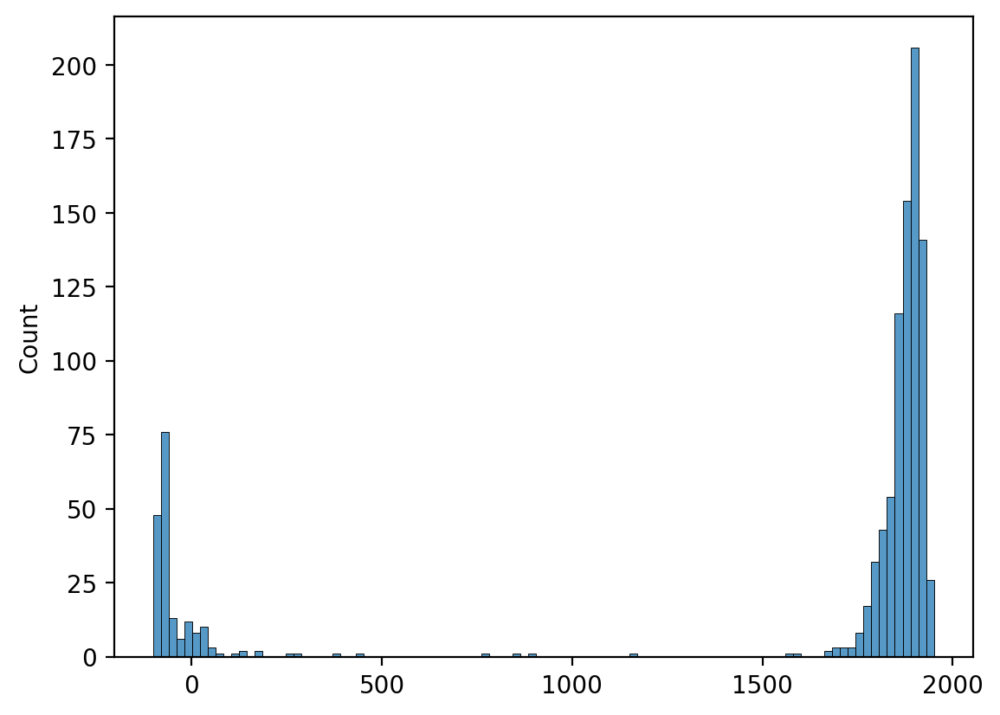

In [ ]:
#@markdown #### Histogram of TD3 Rewards
log_dir = '/content/drive/MyDrive/DRL/td3/'

# Create and wrap the environment
env = gym.make("HumanoidBulletEnv-v0")
env = Monitor(env, log_dir)

model = TD3.load(log_dir + "td3_humanoid.zip", env=env, verbose=2)

# Initialize values
num_iter=1000
ep_steps=2000
all_reward = []
num_steps  = []
done = 0

# Iterate over each episode
for i in range(num_iter):
  obs = env.reset() # Reset environment
  total_reward = 0 # initialize total reward for accumulation
  for s in range(ep_steps):
    action, _states = model.predict(obs) # make a prediction
    obs, reward, done, info = env.step(action) # take a step
    total_reward += reward # add to total reward
    #print('Total Reward: ', total_reward)
    if done:
      all_reward.append(total_reward) # append to initial list
      num_steps.append(s) # append number of episode steps
      #print('All reward: ', all_reward) # should fall b/w 1100-1200
      #print('Num steps: ', num_steps)
      break

# Plot histogram of the total reward of model
import seaborn as sns
sns.histplot(all_reward)
plt.show()

## Save as npz
# all_reward = np.savez("td3_1000iter_humanoid",
                       # all_reward=all_reward,checkpoint=log_dir) 

In [ ]:
# Save as npz
log_dir = '/content/drive/MyDrive/DRL/td3/td3_humanoid.zip'
all_reward = np.savez("td3_1000iter_humanoid",
                       all_reward=all_reward,num_steps=num_steps,checkpoint=log_dir) 

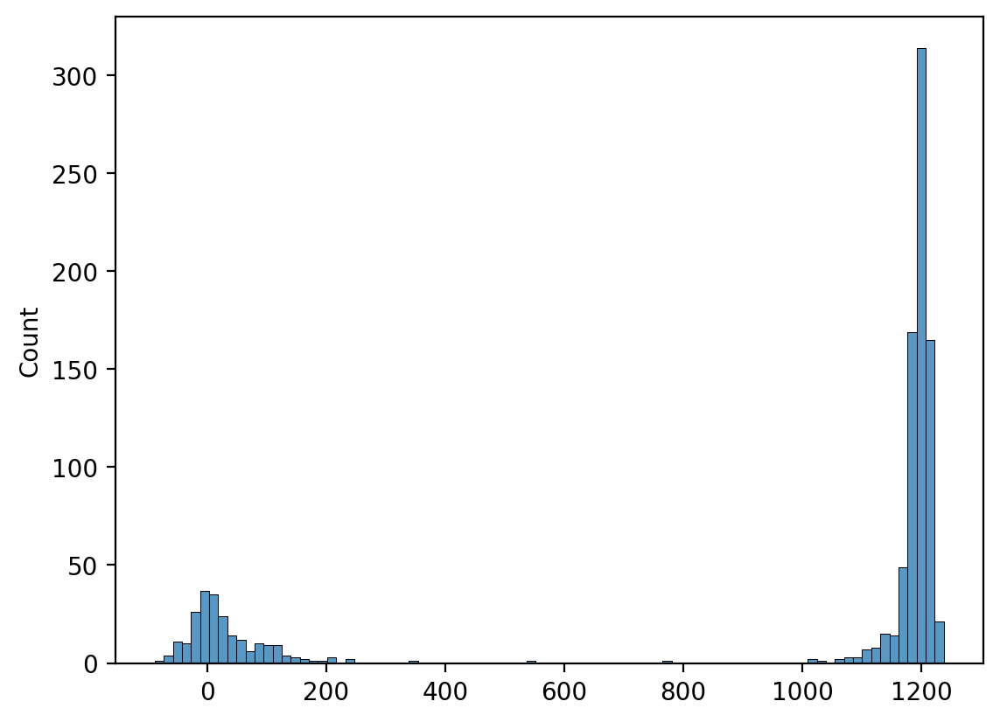

In [ ]:
with np.load('sac_1000iter_humanoid.npz',allow_pickle=True) as data:
  all_reward = data['all_reward']
  checkpoint = data['checkpoint']

import seaborn as sns
sns.histplot(all_reward)
plt.show()

# print(all_reward)

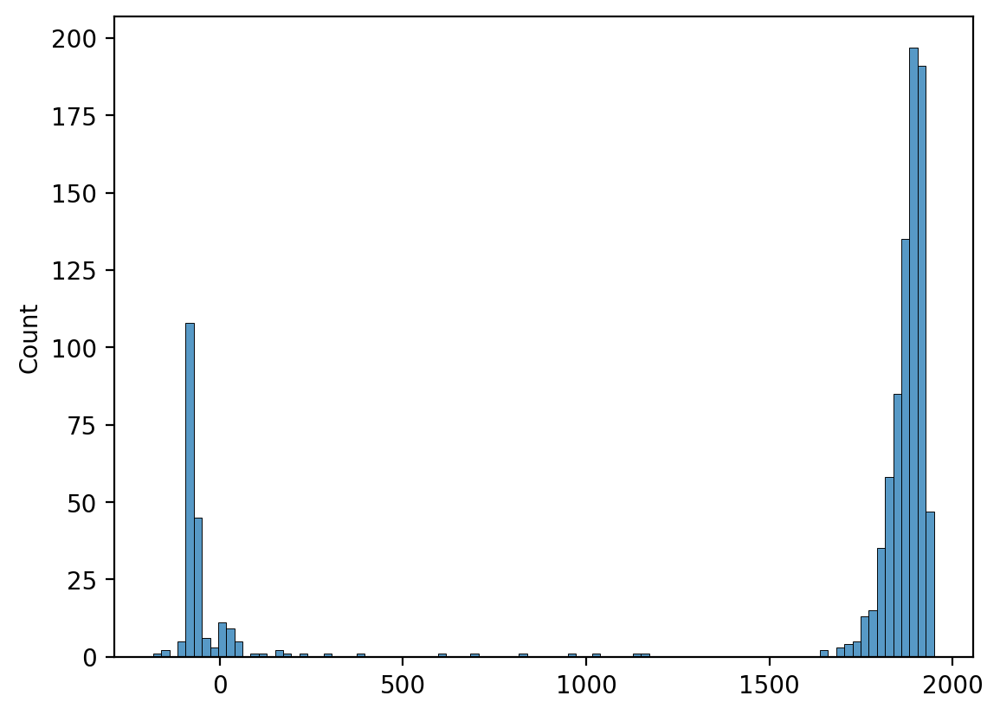

In [ ]:
with np.load('td3_1000iter_humanoid.npz',allow_pickle=True) as data:
  all_reward = data['all_reward']
  checkpoint = data['checkpoint']

import seaborn as sns
sns.histplot(all_reward)
plt.show()

# print(all_reward)

In [ ]:
#@markdown #### other
env_dict = gym.envs.registration.registry.env_specs.copy()


for env in env_dict:
  if 'HumanoidBulletEnv-v0' in env:
    print('Here I am!') 
    del gym.envs.registration.registry.env_specs[env]


import gym
import pybullet_envs.deep_mimic.env.pybullet_deep_mimic_env
from   pybullet_utils.arg_parser import ArgParser
# from   pybullet_utils.logger import Logger
from   pybullet_envs.deep_mimic.env.pybullet_deep_mimic_env import PyBulletDeepMimicEnv
# from pybullet_envs.deep_mimic.learning.rl_world import RLWorld
# from pybullet_envs.deep_mimic.learning.ppo_agent import PPOAgent
from pybullet_envs.deep_mimic.learning.path import *


gym.envs.registration.register('HumanoidBulletEnv-v0', 
        entry_point='pybullet_envs.deep_mimic.env.pybullet_deep_mimic_env:PyBulletDeepMimicEnv', 
        max_episode_steps=1000)

env_name='HumanoidBulletEnv-v0'
env = gym.make(env_name)

# # Iterate n amount of times
# num_iter=1000
# all_reward = 0 # initialize list to accumulate rewards
# done=0 

# # Iterate over each episode
# for i in range(num_iter):
#   obs = env.reset() # Reset environment
#   total_reward = 0 # initialize total reward list for accumulation
#   while not done:
#     action, _states = model.predict(obs) # make a prediction
#     obs, reward, done, info = env.step(action) # take a step
#     total_reward+=reward # add to taol reward
#     if done:
#       obs = env.reset() # reset environment once done

#   all_reward+=total_reward # append to initial list
  
# print(all_reward)